Encontrar diferenças entre as imagens
[Tutorial](https://www.pyimagesearch.com/2017/06/19/image-difference-with-opencv-and-python/)

In [21]:
pip install --upgrade scikit-image imutils opencv-python

Requirement already up-to-date: scikit-image in /usr/local/lib/python3.6/dist-packages (0.16.2)
Requirement already up-to-date: imutils in /usr/local/lib/python3.6/dist-packages (0.5.3)
Requirement already up-to-date: opencv-python in /usr/local/lib/python3.6/dist-packages (4.1.2.30)


In [36]:
# import the necessary packages
from skimage.measure import compare_ssim
import argparse
import imutils
import cv2
from google.colab.patches import cv2_imshow

# load the two input images
imageA = cv2.imread('GE01_2011_JPEG_R1C1.jpg')
imageB = cv2.imread('WV02_2019_JPEG_R1C1.jpg')

# convert the images to grayscale
grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

grayB = cv2.resize(grayB, (grayA.shape[1], grayA.shape[0]))

print(grayA.shape)
print(grayB.shape)


(2361, 4220)
(2361, 4220)


In [37]:
# compute the Structural Similarity Index (SSIM) between the two
# images, ensuring that the difference image is returned
(score, diff) = compare_ssim(grayB, grayA, full=True)
diff = (diff * 255).astype("uint8")
print("SSIM: {}".format(score))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.
  """Entry point for launching an IPython kernel.


SSIM: 0.5150230993206052


In [0]:
# threshold the difference image, followed by finding contours to
# obtain the regions of the two input images that differ
thresh = cv2.threshold(diff, 0, 255,
	cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)[1]
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
	cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)

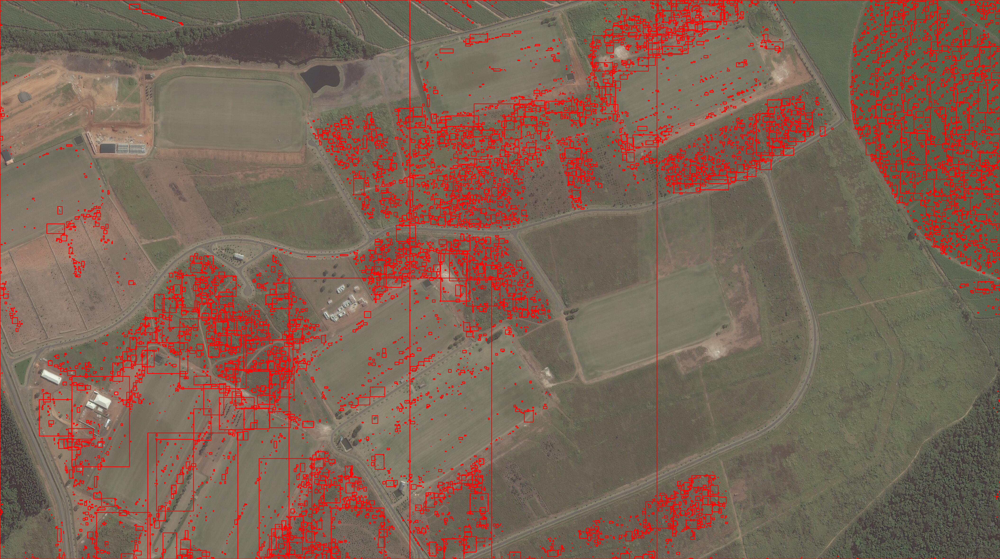

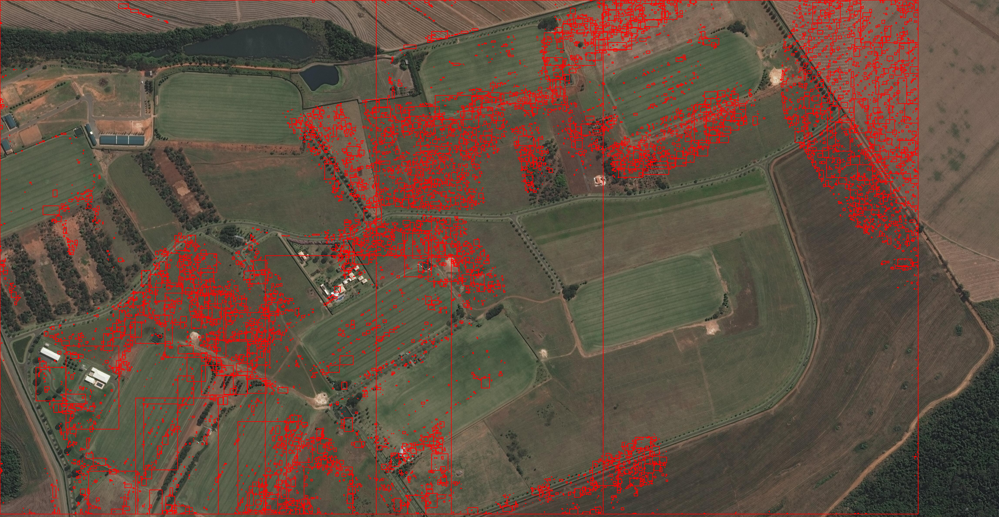

-1

In [39]:
from google.colab.patches import cv2_imshow

# loop over the contours
for c in cnts:
	# compute the bounding box of the contour and then draw the
	# bounding box on both input images to represent where the two
	# images differ
	(x, y, w, h) = cv2.boundingRect(c)
	cv2.rectangle(imageA, (x, y), (x + w, y + h), (0, 0, 255), 2)
	cv2.rectangle(imageB, (x, y), (x + w, y + h), (0, 0, 255), 2)

# show the output images
cv2_imshow(imageA)
cv2_imshow(imageB)

Registro

In [0]:
# import cv2 
# import os
# import numpy as np 

In [0]:
# # Open the image files. 
# img2_color = cv2.imread("GE01_2011_JPEG_R1C1.jpg") # Reference image.
# img2 = cv2.cvtColor(img2_color, cv2.COLOR_BGR2GRAY)
# height, width = img2.shape 

In [0]:
# DATADIR = "./data"
# path = os.path.join(DATADIR)

In [0]:
# for img in os.listdir(path):
#     try:
#         img1_color = cv2.imread(os.path.join(path, img)) # Image to be aligned.
#         img1 = cv2.cvtColor(img1_color, cv2.COLOR_BGR2GRAY) 
        
#         # Create ORB detector with 5000 features. 
#         orb_detector = cv2.ORB_create(5000)
        
#         # Find keypoints and descriptors. 
#         # The first arg is the image, second arg is the mask 
#         # (which is not reqiured in this case). 
#         kp1, d1 = orb_detector.detectAndCompute(img1, None) 
#         kp2, d2 = orb_detector.detectAndCompute(img2, None)
        
#         # Match features between the two images. 
#         # We create a Brute Force matcher with 
#         # Hamming distance as measurement mode. 
#         matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)
        
#         # Match the two sets of descriptors. 
#         matches = matcher.match(d1, d2)
        
#         # Sort matches on the basis of their Hamming distance. 
#         matches.sort(key = lambda x: x.distance)
        
#         # Take the top 90 % matches forward. 
#         matches = matches[:int(len(matches)*90)] 
#         no_of_matches = len(matches)
        
#         # Define empty matrices of shape no_of_matches * 2. 
#         p1 = np.zeros((no_of_matches, 2)) 
#         p2 = np.zeros((no_of_matches, 2))
        
#         for i in range(len(matches)): 
#             p1[i, :] = kp1[matches[i].queryIdx].pt 
#             p2[i, :] = kp2[matches[i].trainIdx].pt 
        
#         # Find the homography matrix. 
#         homography, mask = cv2.findHomography(p1, p2, cv2.RANSAC)
        
#         # Use this matrix to transform the 
#         # colored image wrt the reference image. 
#         transformed_img = cv2.warpPerspective(img1_color, 
#                             homography, (width, height))
        
#         # Save the output. 
#         cv2.imwrite('newimg' + img + '.jpg', transformed_img) 
        
#     except Exception as e:
#         pass
            